In [1]:
!pip install tensorflow

In [2]:
import numpy as np
import random
import matplotlib.pyplot as plt
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Dense, Flatten

# Load Dataset

In [3]:
X_train = np.loadtxt('input.csv', delimiter = ',')
Y_train = np.loadtxt('labels.csv', delimiter = ',')

X_test = np.loadtxt('input_test.csv', delimiter = ',')
Y_test = np.loadtxt('labels_test.csv', delimiter = ',')

In [4]:
X_train = X_train.reshape(len(X_train), 100, 100, 3)
Y_train = Y_train.reshape(len(Y_train), 1)

X_test = X_test.reshape(len(X_test), 100, 100, 3)
Y_test = Y_test.reshape(len(Y_test), 1)

X_train = X_train/255.0
X_test = X_test/255.0

In [5]:
print("Shape of X_train: ", X_train.shape)
print("Shape of Y_train: ", Y_train.shape)
print("Shape of X_test: ", X_test.shape)
print("Shape of Y_test: ", Y_test.shape)

Shape of X_train:  (2000, 100, 100, 3)
Shape of Y_train:  (2000, 1)
Shape of X_test:  (400, 100, 100, 3)
Shape of Y_test:  (400, 1)


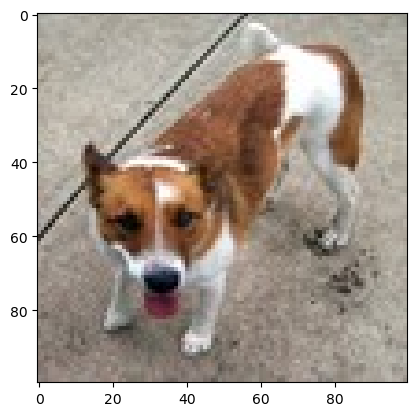

In [32]:
idx = random.randint(0, len(X_train))
plt.imshow(X_train[idx, :])
plt.show()

In [33]:
from PIL import Image

image_array = X_train[idx, :]

image_array_scaled = (image_array * 255).astype(np.uint8)

image = Image.fromarray(image_array_scaled)

image.save("output_image.jpg")

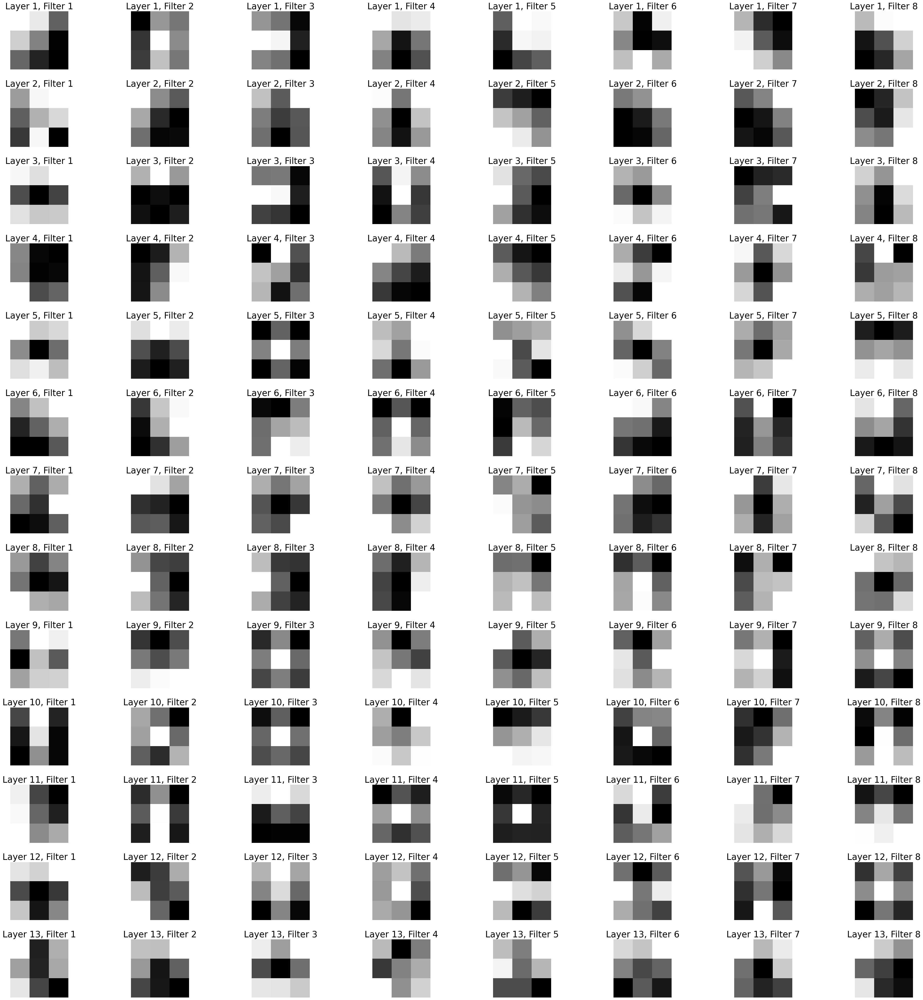

In [34]:
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf

image_path = "output_image.jpg"
image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
image_array = tf.keras.preprocessing.image.img_to_array(image)
image_array = np.expand_dims(image_array, axis=0)

model = tf.keras.applications.VGG16(weights='imagenet', include_top=True)

conv_layers = [layer for layer in model.layers if isinstance(layer, tf.keras.layers.Conv2D)]

num_filters = 8

plt.figure(figsize=(40, 40))
for i, layer in enumerate(conv_layers):
    filters = layer.get_weights()[0]
    for j in range(num_filters):
        plt.subplot(len(conv_layers), num_filters, i * num_filters + j + 1)
        filter_image = filters[:, :, :, j]
        filter_height, filter_width, input_channels = filter_image.shape
        reshaped_filter = np.zeros((filter_height, filter_width))
        for k in range(input_channels):
            reshaped_filter += filter_image[:, :, k]
        plt.imshow(reshaped_filter, cmap='gray')
        plt.axis('off')
        plt.title(f'Layer {i + 1}, Filter {j + 1}', fontsize=25) 
plt.tight_layout(h_pad=3.0) 
plt.show()

1/1 [==============================] - 1s 788ms/step


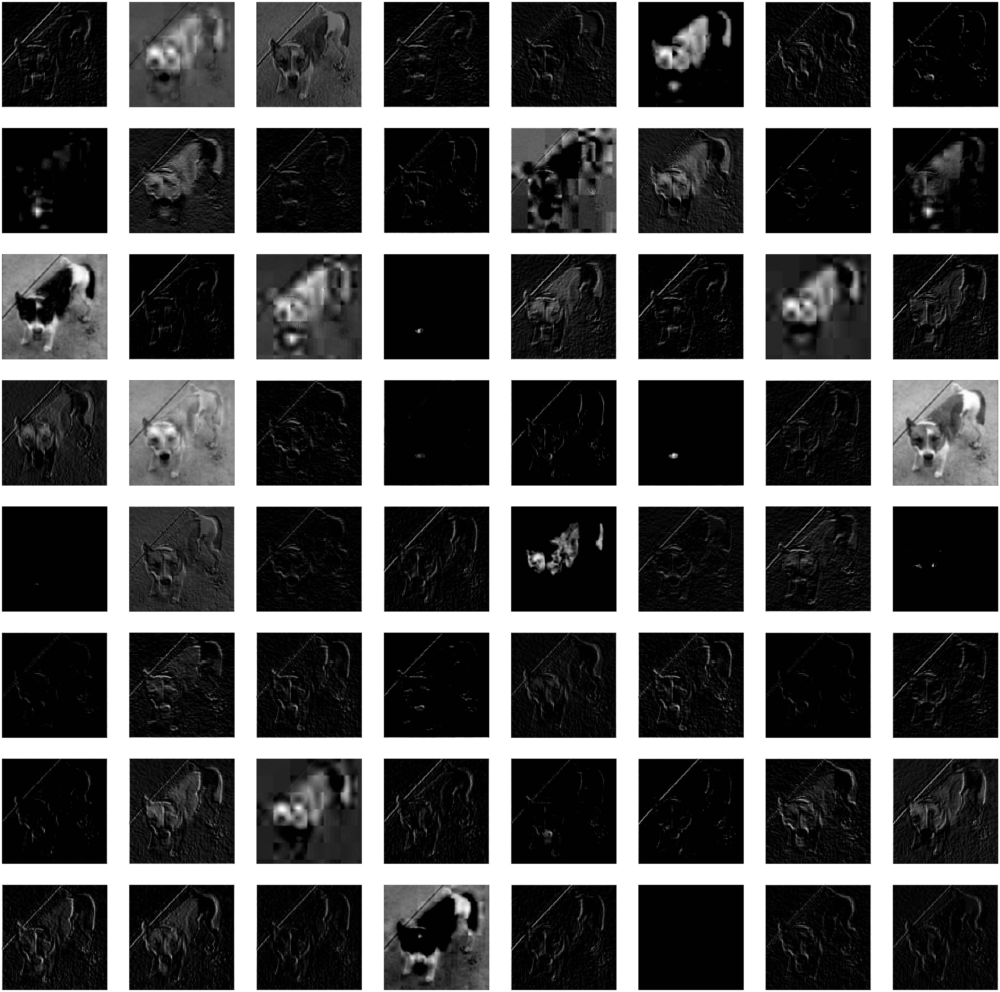

In [35]:
import tensorflow as tf
import matplotlib.pyplot as plt

image_path = "output_image.jpg"
image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
image_array = tf.keras.preprocessing.image.img_to_array(image)
image_array = np.expand_dims(image_array, axis=0)

model = tf.keras.applications.VGG16(weights='imagenet', include_top=True)

conv_layers_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]

activation_model = tf.keras.models.Model(inputs=model.input, outputs=conv_layers_outputs)

activations = activation_model.predict(image_array)

num_filters = activations[0].shape[-1]
size = activations[0].shape[1]
    
cols = 8
rows = num_filters // cols + 1

image_size = 8  

plt.figure(figsize=(cols * image_size, rows * image_size))
for i in range(num_filters):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(activations[0][0, :, :, i], cmap='gray')
    plt.axis('off')
plt.show()

1/1 [==============================] - 1s 556ms/step


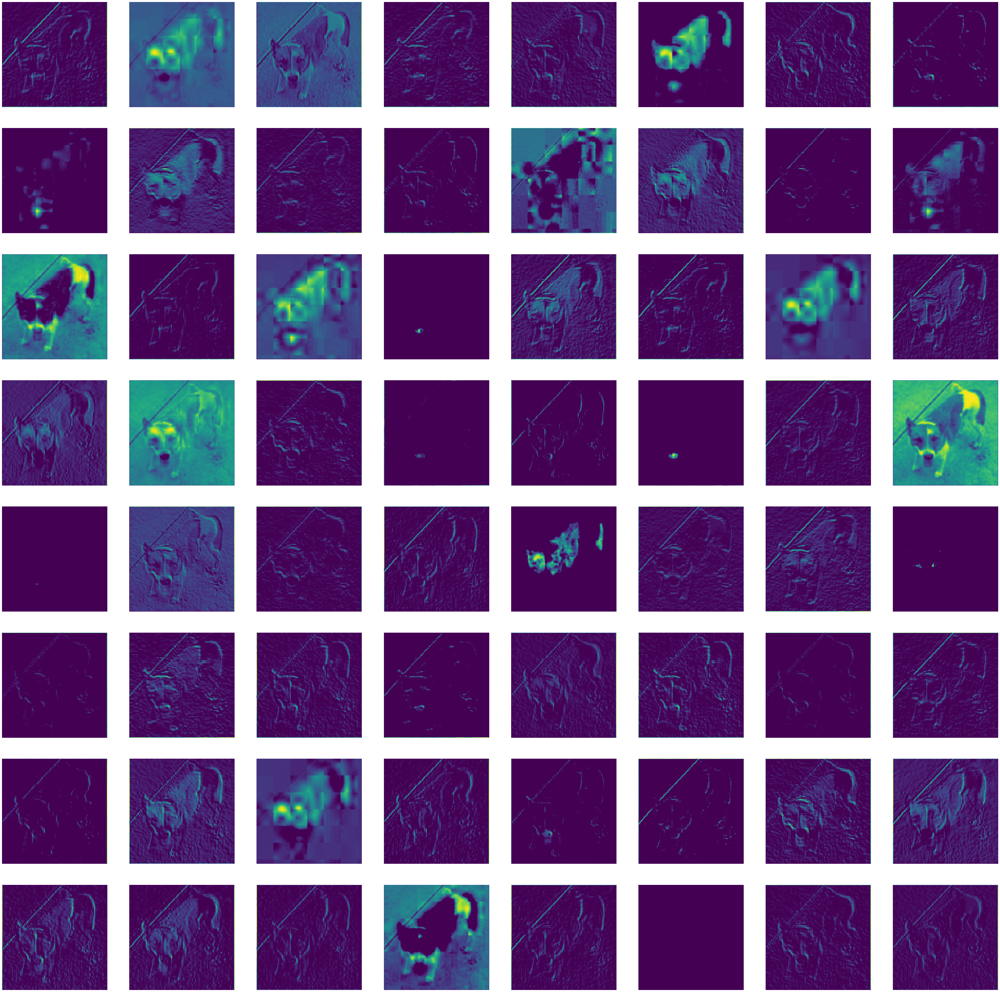

In [36]:
import tensorflow as tf
import matplotlib.pyplot as plt

image_path = "output_image.jpg"
image = tf.keras.preprocessing.image.load_img(image_path, target_size=(224, 224))
image_array = tf.keras.preprocessing.image.img_to_array(image)
image_array = np.expand_dims(image_array, axis=0)

model = tf.keras.applications.VGG16(weights='imagenet', include_top=True)

conv_layers_outputs = [layer.output for layer in model.layers if 'conv' in layer.name]

activation_model = tf.keras.models.Model(inputs=model.input, outputs=conv_layers_outputs)

activations = activation_model.predict(image_array)

num_filters = activations[0].shape[-1]
size = activations[0].shape[1]
    
cols = 8
rows = num_filters // cols + 1

image_size = 8  

plt.figure(figsize=(cols * image_size, rows * image_size))
for i in range(num_filters):
    plt.subplot(rows, cols, i + 1)
    plt.imshow(activations[0][0, :, :, i], cmap='viridis')
    plt.axis('off')
plt.show()

# Model

In [37]:
model = Sequential([
    Conv2D(32, (3,3), activation = 'relu', input_shape = (100, 100, 3)),
    MaxPooling2D((2,2)),
    
    Conv2D(32, (3,3), activation = 'relu'),
    MaxPooling2D((2,2)),
    
    Flatten(),
    Dense(64, activation = 'relu'),
    Dense(1, activation = 'sigmoid')
])

In [38]:
model = Sequential()

model.add(Conv2D(32, (3,3), activation = 'relu', input_shape = (100, 100, 3)))
model.add(MaxPooling2D((2,2)))

model.add(Conv2D(32, (3,3), activation = 'relu'))
model.add(MaxPooling2D((2,2)))

model.add(Flatten())
model.add(Dense(64, activation = 'relu'))
model.add(Dense(1, activation = 'sigmoid'))

In [39]:
model.compile(loss = 'binary_crossentropy', optimizer = 'adam', metrics = ['accuracy'])

In [40]:
history = model.fit(X_train, Y_train, epochs = 5, batch_size = 64, validation_data=(X_test, Y_test))

Epoch 1/5
32/32 [==============================] - 9s 217ms/step - loss: 0.7150 - accuracy: 0.5145 - val_loss: 0.6871 - val_accuracy: 0.5500
Epoch 2/5
32/32 [==============================] - 6s 177ms/step - loss: 0.6768 - accuracy: 0.5760 - val_loss: 0.6716 - val_accuracy: 0.5350
Epoch 3/5
32/32 [==============================] - 5s 156ms/step - loss: 0.6145 - accuracy: 0.6530 - val_loss: 0.7847 - val_accuracy: 0.5325
Epoch 4/5
32/32 [==============================] - 5s 156ms/step - loss: 0.5655 - accuracy: 0.7100 - val_loss: 0.5908 - val_accuracy: 0.7075
Epoch 5/5
32/32 [==============================] - 5s 154ms/step - loss: 0.4946 - accuracy: 0.7605 - val_loss: 0.6154 - val_accuracy: 0.6950


In [41]:
model.evaluate(X_test, Y_test)

13/13 [==============================] - 0s 24ms/step - loss: 0.6154 - accuracy: 0.6950


[0.6154358386993408, 0.6949999928474426]

In [42]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_10 (Conv2D)          (None, 98, 98, 32)        896       
                                                                 
 max_pooling2d_10 (MaxPooli  (None, 49, 49, 32)        0         
 ng2D)                                                           
                                                                 
 conv2d_11 (Conv2D)          (None, 47, 47, 32)        9248      
                                                                 
 max_pooling2d_11 (MaxPooli  (None, 23, 23, 32)        0         
 ng2D)                                                           
                                                                 
 flatten_5 (Flatten)         (None, 16928)             0         
                                                                 
 dense_10 (Dense)            (None, 64)               

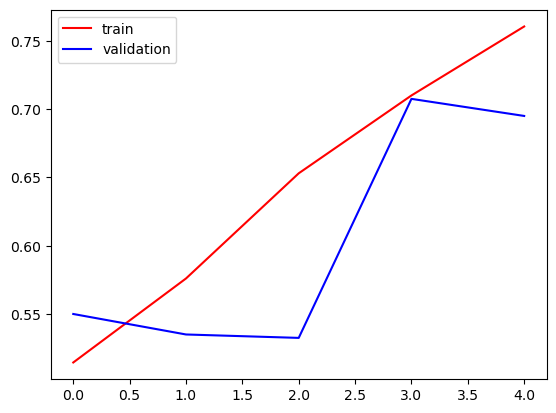

In [43]:
plt.plot(history.history['accuracy'],color='red',label='train')
plt.plot(history.history['val_accuracy'],color='blue',label='validation')
plt.legend()
plt.show()

# Making predictions

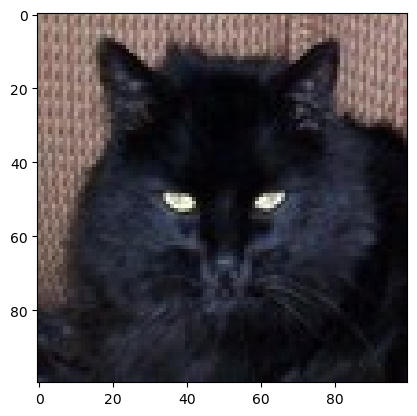

1/1 [==============================] - 0s 38ms/step
Our model says it is a  cat


In [48]:
idx2 = random.randint(0, len(Y_test))
plt.imshow(X_test[idx2, :])
plt.show()

y_pred = model.predict(X_test[idx2, :].reshape(1, 100, 100, 3))
y_pred = y_pred > 0.5

if(y_pred == 0):
    pred = 'dog'
else:
    pred = 'cat'
    
print("Our model says it is a ", pred)